<a href="https://colab.research.google.com/github/ming0520/AI-Assignment/blob/dev/Auto_Edit_Module.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!apt-get install ffmpeg -y
!wget https://raw.githubusercontent.com/ming0520/Timecode/master/Timecode.py
!wget https://raw.githubusercontent.com/ming0520/FYP-Sample/master/Video1.mp4
!pip3 install --upgrade pip
!pip3 install auto-editor --upgrade

Reading package lists... Done
Building dependency tree       
Reading state information... Done
ffmpeg is already the newest version (7:3.4.8-0ubuntu0.2).
0 upgraded, 0 newly installed, 0 to remove and 21 not upgraded.
--2020-10-22 06:21:35--  https://raw.githubusercontent.com/ming0520/Timecode/master/Timecode.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3469 (3.4K) [text/plain]
Saving to: ‘Timecode.py’

Timecode.py         100%[===================>]   3.39K  --.-KB/s    in 0s      

2020-10-22 06:21:35 (46.7 MB/s) - ‘Timecode.py’ saved [3469/3469]

--2020-10-22 06:21:35--  https://raw.githubusercontent.com/ming0520/FYP-Sample/master/Video1.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133,

In [ ]:
!pip install pytube3

In [ ]:
#for display the video in colab
from IPython.display import HTML
from base64 import b64encode
'''auto-editor.py'''
#python auto-editor.py lib.mp4 --frame_margin 8 --silent_threshold 0.03
# external python libraries
from scipy.io import wavfile
import numpy as np
from tqdm import tqdm

# internal python libraries
import time
import math
import os
import subprocess
from shutil import move, rmtree, copyfile

# developed library
from Timecode import Timecode
from pytube import YouTube
import librosa
import librosa.display
import matplotlib.pyplot as plt

In [ ]:
yt = YouTube('https://www.youtube.com/watch?v=oWhjuTtmyVM')
stream = yt.streams.first()
stream.download()
move(f'{yt.title}.mp4','real1.mp4')

'real1.mp4'

In [ ]:
filename = 'real1.mp4'
outdir ='.'
actual_filename = 'real1'
os.system('ffmpeg -i {} -acodec pcm_s16le -ar 16000 {}/{}.wav'.format(filename, outdir, actual_filename))

0

https://stackoverflow.com/questions/49669298/conversing-mp4-to-wav-with-the-same-file-name-in-python

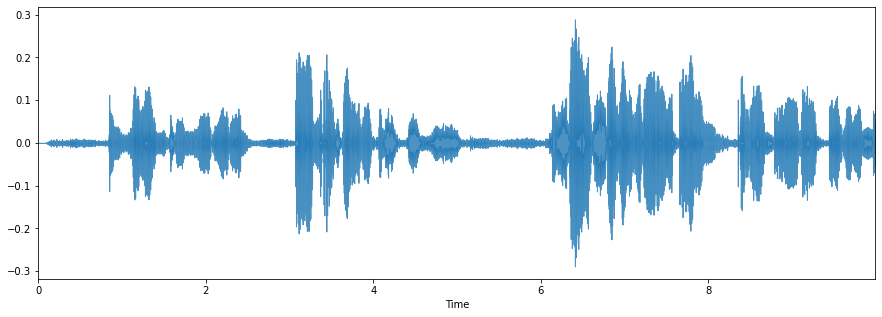

In [ ]:
y, sr = librosa.load('real1.wav',duration=10)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(y, sr, alpha=0.8)

In [ ]:
os.system(f'auto-editor real1.wav')

0

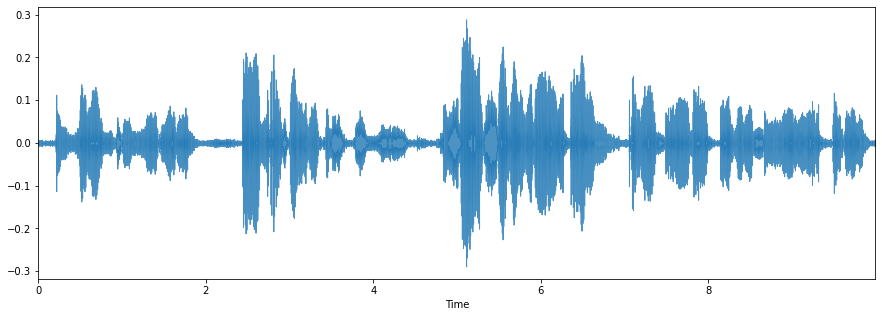

In [ ]:
y, sr = librosa.load('real1_ALTERED.wav',duration=10)
plt.figure(figsize=(15, 5))
librosa.display.waveplot(y, sr, alpha=0.8)

In [ ]:
!ffmpeg -y -i "real1_ALTERED.wav" -acodec pcm_s16le -ac 1 -ar 16000 -af lowpass=3000,highpass=200 "converted.wav"

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [ ]:
import requests
import json

headers = {
    'Content-Type': 'audio/wav',
}

params = (
    ('model', 'en-US_BroadbandModel'),
    ('timestamps', 'true'),
    ('max_alternatives', '3'),
)

data = open('converted.wav', 'rb').read()
response = requests.post('https://api.jp-tok.speech-to-text.watson.cloud.ibm.com/instances/69250ebc-5a34-42a0-9096-ab9b382e2c25/v1/recognize', 
                         headers=headers, params=params, data=data, auth=('apikey', 'P75zKPwgFW2iwgbKS2GGApeuT84TymaJuFhFF88mYrPN'))

In [ ]:
watson = response.json()
results = watson['results']
for result in results:
    alternatives = result['alternatives']
    transcript = alternatives[1]['transcript']

print(transcript)

I'm feeling sticking my tongue L. %HESITATION I don't really know why I don't really know where where that came from that kind of works so can helps me %HESITATION with blocking %HESITATION and and %HESITATION %HESITATION that's about it %HESITATION I know this is a quick random little video %HESITATION I plan on making more videos this week %HESITATION with Tommy %HESITATION not gonna tell you what they are yet but I I think you guys might enjoy them might not I really don't know these two videos that were gonna make or break are you shoot or can be really different so I don't know how that's gonna play out %HESITATION but yeah %HESITATION anyways if you guys like the video %HESITATION like it comments %HESITATION comment what you will want to see next door if you have any questions about scattering or about my experiences with it %HESITATION or just ideas for pretty much any video %HESITATION just laid down in the comments below %HESITATION and yeah %HESITATION sh share with your fri

In [ ]:
with open('data.json', 'w') as f:
    json.dump(watson, f)

In [101]:
class Timestamp:
  def __init__(self,start = 0.0, end = 0.0, text='text'):
    self.start = start
    self.end = end
    self.text = text

  

In [91]:
timestamps = watson['results'][0]['alternatives'][0]['timestamps']

In [102]:
ts_list = []
for timestamp in timestamps:
  if (timestamp[0]!="%HESITATION"):
    ts_list.append(Timestamp(timestamp[1],timestamp[2],timestamp[0]))

In [104]:
between = []
for ts in ts_list:
  between.append(f'between(t,{ts.start},{ts.end})') 


In [ ]:
mp4 = open('real1.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)